In [1]:
# Setting SEED
import random
random.seed(123456)

In [2]:
# !pip3 install shap

In [3]:
# Importing Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster
import math
from sklearn.model_selection import train_test_split,GridSearchCV,cross_val_score
import geopy.distance
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
import shap

In [4]:
# !pip3 install folium
# !pip3 install geopy

In [5]:
# Importing the Dataset
df=pd.read_csv("train.csv")

In [6]:
df.head(10)

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2009-06-15 17:26:21.0000001,4.5,2009-06-15 17:26:21 UTC,-73.844311,40.721319,-73.841610,40.712278,1
1,2010-01-05 16:52:16.0000002,16.9,2010-01-05 16:52:16 UTC,-74.016048,40.711303,-73.979268,40.782004,1
2,2011-08-18 00:35:00.00000049,5.7,2011-08-18 00:35:00 UTC,-73.982738,40.761270,-73.991242,40.750562,2
3,2012-04-21 04:30:42.0000001,7.7,2012-04-21 04:30:42 UTC,-73.987130,40.733143,-73.991567,40.758092,1
4,2010-03-09 07:51:00.000000135,5.3,2010-03-09 07:51:00 UTC,-73.968095,40.768008,-73.956655,40.783762,1
5,2011-01-06 09:50:45.0000002,12.1,2011-01-06 09:50:45 UTC,-74.000964,40.731630,-73.972892,40.758233,1
6,2012-11-20 20:35:00.0000001,7.5,2012-11-20 20:35:00 UTC,-73.980002,40.751662,-73.973802,40.764842,1
7,2012-01-04 17:22:00.00000081,16.5,2012-01-04 17:22:00 UTC,-73.951300,40.774138,-73.990095,40.751048,1
8,2012-12-03 13:10:00.000000125,9.0,2012-12-03 13:10:00 UTC,-74.006462,40.726713,-73.993078,40.731628,1
9,2009-09-02 01:11:00.00000083,8.9,2009-09-02 01:11:00 UTC,-73.980658,40.733873,-73.991540,40.758138,2


In [7]:
# Splitting into Train and Test Set
X_train,X_test,y_train,y_test=train_test_split(df.loc[:,['key','pickup_datetime','pickup_longitude','pickup_latitude','dropoff_longitude','dropoff_latitude','passenger_count']],df.loc[:,['fare_amount']],test_size=0.20,random_state=False)

In [8]:
train_df=X_train
test_df=X_test
train_df["fare_amount"]=y_train
test_df["fare_amount"]=y_test

In [9]:
# Exploratory Data Analysis
train_df.head(10)

,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,fare_amount
20330,2010-08-15 05:04:33.0000002,2010-08-15 05:04:33 UTC,-74.005382,40.740163,-73.997277,40.737647,1,13.7
17532,2011-09-02 12:06:00.00000023,2011-09-02 12:06:00 UTC,-73.873023,40.774033,-73.951433,40.712333,1,17.7
45819,2014-06-27 18:18:00.000000187,2014-06-27 18:18:00 UTC,-73.985195,40.723697,-73.989570,40.735362,6,6.5
34807,2012-11-27 09:45:38.0000002,2012-11-27 09:45:38 UTC,-73.955565,40.764788,-73.971449,40.760538,1,9.5
31888,2011-08-04 00:46:00.00000035,2011-08-04 00:46:00 UTC,-73.985755,40.752745,-73.867943,40.902673,1,37.7
48372,2010-09-25 19:49:00.000000179,2010-09-25 19:49:00 UTC,-73.989448,40.747562,-74.000725,40.720907,3,10.9
5524,2012-08-20 09:25:23.0000006,2012-08-20 09:25:23 UTC,-73.990234,40.746795,-74.005542,40.720398,1,8.9
38032,2012-01-12 19:49:20.0000006,2012-01-12 19:49:20 UTC,-73.973100,40.764100,-73.985800,40.735000,1,9.3
14944,2013-03-19 21:48:12.0000004,2013-03-19 21:48:12 UTC,-73.997967,40.740702,-73.993455,40.757107,1,7.0
22793,2009-02-26 21:27:10.0000002,2009-02-26 21:27:10 UTC,-73.975282,40.756160,-73.991107,40.760616,1,6.6


In [10]:
train_df.describe()

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,fare_amount
count,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000
mean,-72.476103,39.912829,-72.473474,39.905526,1.668875,11.406539
std,10.528621,6.410550,10.532961,6.147821,1.287506,9.779972
min,-75.423848,-74.006893,-75.354559,-74.006377,0.000000,-5.000000
25%,-73.992036,40.735010,-73.991112,40.734460,1.000000,6.000000
50%,-73.981808,40.752679,-73.980056,40.753453,1.000000,8.500000
75%,-73.967093,40.767342,-73.963458,40.768204,2.000000,12.500000
max,40.783472,401.083332,40.851027,43.415190,6.000000,200.000000


In [11]:
# Missing Values Check
train_df.isnull().sum()/len(X_train)

key                  0.0
pickup_datetime      0.0
pickup_longitude     0.0
pickup_latitude      0.0
dropoff_longitude    0.0
dropoff_latitude     0.0
passenger_count      0.0
fare_amount          0.0
dtype: float64

<AxesSubplot:>

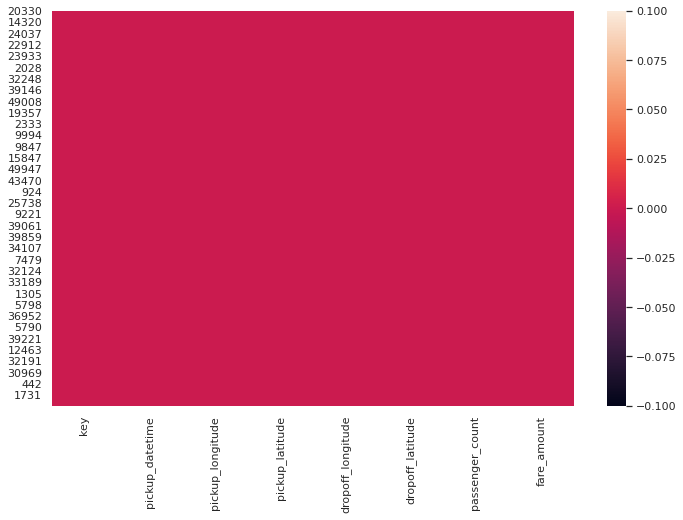

In [12]:
sns.set(rc={'figure.figsize':(11.7,7.27)})
sns.heatmap(train_df.isnull())

<AxesSubplot:>

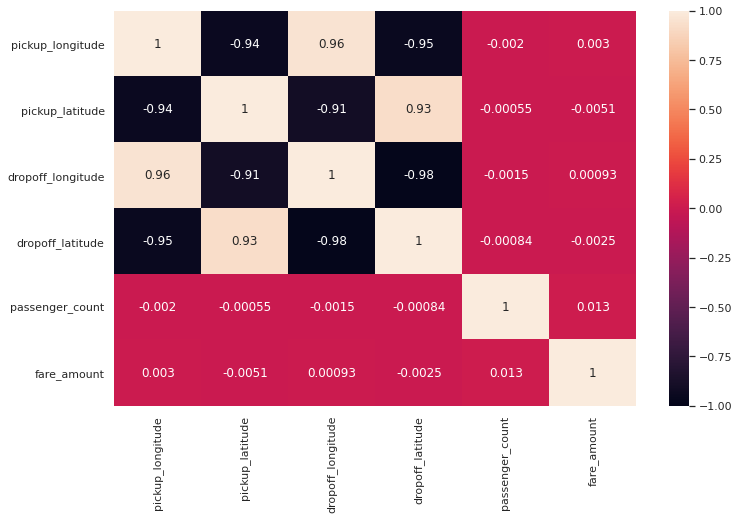

In [13]:
# Correlation Plot
sns.set(rc={'figure.figsize':(11.7,7.27)})
sns.heatmap(train_df.corr(method="pearson"),vmin=-1,vmax=1,annot=True)

<AxesSubplot:>

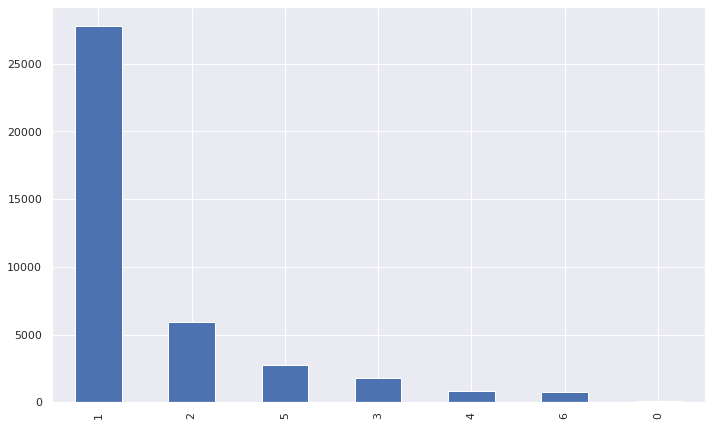

In [14]:
# Passenger Count Distribution
train_df['passenger_count'].value_counts().plot(kind='bar')

In [15]:
# GeoMap
plt.figure(figsize=(10,7))

m_5 = folium.Map(location=[train_df.pickup_latitude[20330],train_df.pickup_longitude[20330]], tiles='cartodbpositron', zoom_start=12)
# Add points to the map
mc = MarkerCluster()
for idx, row in df.iterrows():
    if not math.isnan(row['pickup_latitude']) and not math.isnan(row['pickup_longitude']):
        mc.add_child(Marker([row['pickup_latitude'], row['pickup_longitude']]))
m_5.add_child(mc)

<Figure size 720x504 with 0 Axes>

In [16]:
# GeoMap
plt.figure(figsize=(10,7))

m_5 = folium.Map(location=[train_df.dropoff_latitude[20330],X_train.dropoff_longitude[20330]],tiles='cartodbpositron', zoom_start=12)
# Add points to the map
mc = MarkerCluster()
for idx, row in df.iterrows():
    if not math.isnan(row['dropoff_latitude']) and not math.isnan(row['dropoff_longitude']):
        mc.add_child(Marker([row['dropoff_latitude'], row['dropoff_longitude']]))
m_5.add_child(mc)

<Figure size 720x504 with 0 Axes>

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


Text(0.5, 1.0, 'Fare Distribution')

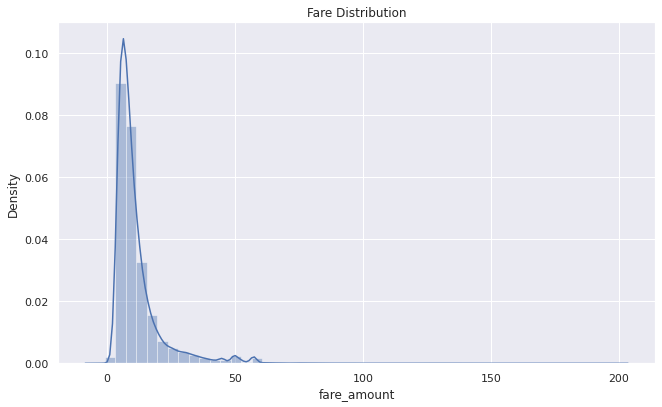

In [17]:
# Checking the Fare Distribution
sns.set(rc={'figure.figsize':(10.7,6.27)})
sns.distplot(train_df.fare_amount).set_title("Fare Distribution")

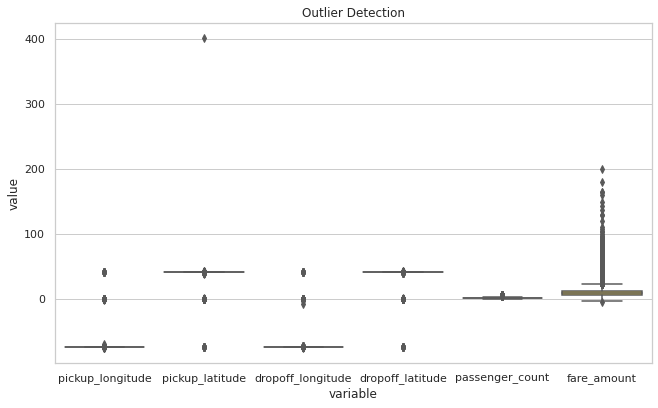

In [18]:
# Outlier Detection
sns.set(style="whitegrid")
sns.boxplot(x="variable", y="value",palette="Set2",data=pd.melt(train_df.iloc[:,2:])).set_title("Outlier Detection")
plt.show()

In [19]:
# Feature Engineering

In [20]:
train_df.head(5)

,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,fare_amount
20330,2010-08-15 05:04:33.0000002,2010-08-15 05:04:33 UTC,-74.005382,40.740163,-73.997277,40.737647,1,13.7
17532,2011-09-02 12:06:00.00000023,2011-09-02 12:06:00 UTC,-73.873023,40.774033,-73.951433,40.712333,1,17.7
45819,2014-06-27 18:18:00.000000187,2014-06-27 18:18:00 UTC,-73.985195,40.723697,-73.989570,40.735362,6,6.5
34807,2012-11-27 09:45:38.0000002,2012-11-27 09:45:38 UTC,-73.955565,40.764788,-73.971449,40.760538,1,9.5
31888,2011-08-04 00:46:00.00000035,2011-08-04 00:46:00 UTC,-73.985755,40.752745,-73.867943,40.902673,1,37.7


In [21]:
def extract_features(dataframe):
    
    dataframe['pickup_datetime']=pd.to_datetime(dataframe['pickup_datetime'])
    day=dataframe['pickup_datetime'].dt.day
    
    month=dataframe['pickup_datetime'].dt.month
    year=dataframe['pickup_datetime'].dt.year

    time=dataframe['pickup_datetime'].dt.time
    
    # Creating Features
    dataframe['day']=day
    dataframe['month']=month
    dataframe['year']=year
    dataframe['time']=time
    
    return dataframe

In [22]:
train_df=extract_features(train_df)
test_df=extract_features(test_df)

In [23]:
train_df.head(10)

,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,fare_amount,day,month,year,time
20330,2010-08-15 05:04:33.0000002,2010-08-15 05:04:33+00:00,-74.005382,40.740163,-73.997277,40.737647,1,13.7,15,8,2010,05:04:33
17532,2011-09-02 12:06:00.00000023,2011-09-02 12:06:00+00:00,-73.873023,40.774033,-73.951433,40.712333,1,17.7,2,9,2011,12:06:00
45819,2014-06-27 18:18:00.000000187,2014-06-27 18:18:00+00:00,-73.985195,40.723697,-73.989570,40.735362,6,6.5,27,6,2014,18:18:00
34807,2012-11-27 09:45:38.0000002,2012-11-27 09:45:38+00:00,-73.955565,40.764788,-73.971449,40.760538,1,9.5,27,11,2012,09:45:38
31888,2011-08-04 00:46:00.00000035,2011-08-04 00:46:00+00:00,-73.985755,40.752745,-73.867943,40.902673,1,37.7,4,8,2011,00:46:00
48372,2010-09-25 19:49:00.000000179,2010-09-25 19:49:00+00:00,-73.989448,40.747562,-74.000725,40.720907,3,10.9,25,9,2010,19:49:00
5524,2012-08-20 09:25:23.0000006,2012-08-20 09:25:23+00:00,-73.990234,40.746795,-74.005542,40.720398,1,8.9,20,8,2012,09:25:23
38032,2012-01-12 19:49:20.0000006,2012-01-12 19:49:20+00:00,-73.973100,40.764100,-73.985800,40.735000,1,9.3,12,1,2012,19:49:20
14944,2013-03-19 21:48:12.0000004,2013-03-19 21:48:12+00:00,-73.997967,40.740702,-73.993455,40.757107,1,7.0,19,3,2013,21:48:12
22793,2009-02-26 21:27:10.0000002,2009-02-26 21:27:10+00:00,-73.975282,40.756160,-73.991107,40.760616,1,6.6,26,2,2009,21:27:10


In [24]:
test_df.head(10)

,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,fare_amount,day,month,year,time
11841,2012-01-26 13:12:00.000000174,2012-01-26 13:12:00+00:00,-73.964505,40.772975,-73.972393,40.760685,5,6.5,26,1,2012,13:12:00
19602,2009-03-18 09:19:00.00000087,2009-03-18 09:19:00+00:00,-73.995110,40.737410,-73.977008,40.779220,1,13.3,18,3,2009,09:19:00
45519,2012-01-04 18:07:49.0000006,2012-01-04 18:07:49+00:00,-73.971585,40.754052,-73.962120,40.759584,1,5.3,4,1,2012,18:07:49
25747,2012-07-17 08:03:00.000000144,2012-07-17 08:03:00+00:00,-73.981619,40.778629,-73.977278,40.765284,1,6.5,17,7,2012,08:03:00
42642,2009-06-27 07:15:00.00000013,2009-06-27 07:15:00+00:00,-73.974092,40.679478,-73.871220,40.774048,1,25.3,27,6,2009,07:15:00
31902,2013-08-15 14:00:00.000000106,2013-08-15 14:00:00+00:00,-73.981022,40.764345,-73.972752,40.780577,1,8.5,15,8,2013,14:00:00
30346,2009-09-03 18:15:47.0000001,2009-09-03 18:15:47+00:00,-74.006012,40.714746,-73.998637,40.725935,3,5.3,3,9,2009,18:15:47
12363,2011-11-17 12:28:00.00000096,2011-11-17 12:28:00+00:00,-73.992120,40.749370,-73.979297,40.753237,6,7.3,17,11,2011,12:28:00
32490,2009-08-12 15:26:56.0000004,2009-08-12 15:26:56+00:00,-73.965915,40.765271,-73.974412,40.761189,2,5.3,12,8,2009,15:26:56
26128,2011-03-26 08:09:00.00000048,2011-03-26 08:09:00+00:00,-73.987920,40.719040,-73.987920,40.719040,1,4.9,26,3,2011,08:09:00


In [25]:
def compute_distance(dataframe):
    
    for index,rows in dataframe.iterrows():
        try:
            pickup_latitude=rows['pickup_latitude']
            pickup_longitude=rows['pickup_longitude']
            dropoff_latitude=rows['dropoff_latitude']
            dropoff_longitude=rows['dropoff_longitude']

            pickup_coords=(pickup_latitude,pickup_longitude)

            dropoff_coords=(dropoff_latitude,dropoff_longitude)
            distance=geopy.distance.geodesic(pickup_coords,dropoff_coords).km
            dataframe.loc[index,'distance(KM)']=distance

        except Exception as e:
            
            continue
            
    return dataframe

In [26]:
train_df=compute_distance(train_df)
test_df=compute_distance(test_df)

Latitude normalization has been prohibited in the newer versions of geopy, because the normalized value happened to be on a different pole, which is probably not what was meant. If you pass coordinates as positional args, please make sure that the order is (latitude, longitude) or (y, x) in Cartesian terms.


In [27]:
train_df.head(10)

,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,fare_amount,day,month,year,time,distance(KM)
20330,2010-08-15 05:04:33.0000002,2010-08-15 05:04:33+00:00,-74.005382,40.740163,-73.997277,40.737647,1,13.7,15,8,2010,05:04:33,0.739419
17532,2011-09-02 12:06:00.00000023,2011-09-02 12:06:00+00:00,-73.873023,40.774033,-73.951433,40.712333,1,17.7,2,9,2011,12:06:00,9.529145
45819,2014-06-27 18:18:00.000000187,2014-06-27 18:18:00+00:00,-73.985195,40.723697,-73.989570,40.735362,6,6.5,27,6,2014,18:18:00,1.347077
34807,2012-11-27 09:45:38.0000002,2012-11-27 09:45:38+00:00,-73.955565,40.764788,-73.971449,40.760538,1,9.5,27,11,2012,09:45:38,1.421803
31888,2011-08-04 00:46:00.00000035,2011-08-04 00:46:00+00:00,-73.985755,40.752745,-73.867943,40.902673,1,37.7,4,8,2011,00:46:00,19.389960
48372,2010-09-25 19:49:00.000000179,2010-09-25 19:49:00+00:00,-73.989448,40.747562,-74.000725,40.720907,3,10.9,25,9,2010,19:49:00,3.109512
5524,2012-08-20 09:25:23.0000006,2012-08-20 09:25:23+00:00,-73.990234,40.746795,-74.005542,40.720398,1,8.9,20,8,2012,09:25:23,3.203901
38032,2012-01-12 19:49:20.0000006,2012-01-12 19:49:20+00:00,-73.973100,40.764100,-73.985800,40.735000,1,9.3,12,1,2012,19:49:20,3.404870
14944,2013-03-19 21:48:12.0000004,2013-03-19 21:48:12+00:00,-73.997967,40.740702,-73.993455,40.757107,1,7.0,19,3,2013,21:48:12,1.861186
22793,2009-02-26 21:27:10.0000002,2009-02-26 21:27:10+00:00,-73.975282,40.756160,-73.991107,40.760616,1,6.6,26,2,2009,21:27:10,1.424967


In [28]:
test_df.head(10)

,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,fare_amount,day,month,year,time,distance(KM)
11841,2012-01-26 13:12:00.000000174,2012-01-26 13:12:00+00:00,-73.964505,40.772975,-73.972393,40.760685,5,6.5,26,1,2012,13:12:00,1.518623
19602,2009-03-18 09:19:00.00000087,2009-03-18 09:19:00+00:00,-73.995110,40.737410,-73.977008,40.779220,1,13.3,18,3,2009,09:19:00,4.888115
45519,2012-01-04 18:07:49.0000006,2012-01-04 18:07:49+00:00,-73.971585,40.754052,-73.962120,40.759584,1,5.3,4,1,2012,18:07:49,1.008072
25747,2012-07-17 08:03:00.000000144,2012-07-17 08:03:00+00:00,-73.981619,40.778629,-73.977278,40.765284,1,6.5,17,7,2012,08:03:00,1.526599
42642,2009-06-27 07:15:00.00000013,2009-06-27 07:15:00+00:00,-73.974092,40.679478,-73.871220,40.774048,1,25.3,27,6,2009,07:15:00,13.631551
31902,2013-08-15 14:00:00.000000106,2013-08-15 14:00:00+00:00,-73.981022,40.764345,-73.972752,40.780577,1,8.5,15,8,2013,14:00:00,1.933047
30346,2009-09-03 18:15:47.0000001,2009-09-03 18:15:47+00:00,-74.006012,40.714746,-73.998637,40.725935,3,5.3,3,9,2009,18:15:47,1.390010
12363,2011-11-17 12:28:00.00000096,2011-11-17 12:28:00+00:00,-73.992120,40.749370,-73.979297,40.753237,6,7.3,17,11,2011,12:28:00,1.164947
32490,2009-08-12 15:26:56.0000004,2009-08-12 15:26:56+00:00,-73.965915,40.765271,-73.974412,40.761189,2,5.3,12,8,2009,15:26:56,0.848656
26128,2011-03-26 08:09:00.00000048,2011-03-26 08:09:00+00:00,-73.987920,40.719040,-73.987920,40.719040,1,4.9,26,3,2011,08:09:00,0.000000


In [29]:
train_df.isnull().sum()

key                  0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    0
dropoff_latitude     0
passenger_count      0
fare_amount          0
day                  0
month                0
year                 0
time                 0
distance(KM)         1
dtype: int64

In [30]:
test_df.isnull().sum()

key                  0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    0
dropoff_latitude     0
passenger_count      0
fare_amount          0
day                  0
month                0
year                 0
time                 0
distance(KM)         0
dtype: int64

In [31]:
train_df.dropna(axis=0,inplace=True)
test_df.dropna(axis=0,inplace=True)

In [32]:
train_df.isnull().sum()

key                  0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    0
dropoff_latitude     0
passenger_count      0
fare_amount          0
day                  0
month                0
year                 0
time                 0
distance(KM)         0
dtype: int64

In [33]:
train_df.head(10)

,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,fare_amount,day,month,year,time,distance(KM)
20330,2010-08-15 05:04:33.0000002,2010-08-15 05:04:33+00:00,-74.005382,40.740163,-73.997277,40.737647,1,13.7,15,8,2010,05:04:33,0.739419
17532,2011-09-02 12:06:00.00000023,2011-09-02 12:06:00+00:00,-73.873023,40.774033,-73.951433,40.712333,1,17.7,2,9,2011,12:06:00,9.529145
45819,2014-06-27 18:18:00.000000187,2014-06-27 18:18:00+00:00,-73.985195,40.723697,-73.989570,40.735362,6,6.5,27,6,2014,18:18:00,1.347077
34807,2012-11-27 09:45:38.0000002,2012-11-27 09:45:38+00:00,-73.955565,40.764788,-73.971449,40.760538,1,9.5,27,11,2012,09:45:38,1.421803
31888,2011-08-04 00:46:00.00000035,2011-08-04 00:46:00+00:00,-73.985755,40.752745,-73.867943,40.902673,1,37.7,4,8,2011,00:46:00,19.389960
48372,2010-09-25 19:49:00.000000179,2010-09-25 19:49:00+00:00,-73.989448,40.747562,-74.000725,40.720907,3,10.9,25,9,2010,19:49:00,3.109512
5524,2012-08-20 09:25:23.0000006,2012-08-20 09:25:23+00:00,-73.990234,40.746795,-74.005542,40.720398,1,8.9,20,8,2012,09:25:23,3.203901
38032,2012-01-12 19:49:20.0000006,2012-01-12 19:49:20+00:00,-73.973100,40.764100,-73.985800,40.735000,1,9.3,12,1,2012,19:49:20,3.404870
14944,2013-03-19 21:48:12.0000004,2013-03-19 21:48:12+00:00,-73.997967,40.740702,-73.993455,40.757107,1,7.0,19,3,2013,21:48:12,1.861186
22793,2009-02-26 21:27:10.0000002,2009-02-26 21:27:10+00:00,-73.975282,40.756160,-73.991107,40.760616,1,6.6,26,2,2009,21:27:10,1.424967


In [34]:
def separate_time(dataframe):
    
    dataframe['time']=dataframe['time'].astype(str)
    for index,rows in dataframe.iterrows():
        
        time=rows['time'].split(":")
        dataframe.loc[index,'hour']=time[0]
        dataframe.loc[index,'minutes']=time[1]
        dataframe.loc[index,'seconds']=time[2]
        
    return dataframe

In [35]:
train_df=separate_time(train_df)
test_df=separate_time(test_df)

In [36]:
train_df['hour']=train_df['hour'].astype(int)
test_df["hour"]=test_df["hour"].astype(int)

In [37]:
def get_part_day(x):
    if (x > 4) and (x <= 8):
        return 'Early Morning'
    elif (x > 8) and (x <= 12 ):
        return 'Morning'
    elif (x > 12) and (x <= 16):
        return'Noon'
    elif (x > 16) and (x <= 20) :
        return 'Eve'
    elif (x > 20) and (x <= 24):
        return'Night'
    elif (x <= 4):
        return'Late Night'

In [38]:
train_df['session']=train_df['hour'].apply(lambda x:get_part_day(x))
test_df['session']=test_df['hour'].apply(lambda x:get_part_day(x))

In [39]:
def get_passenger(x):
    if x==1:
        return "Single Passenger"
    elif x>1:
        return "Multi Passenger"
    else:
        return "No Passenger"

In [40]:
train_df['Passenger(Class)']=train_df['passenger_count'].apply(lambda x:get_passenger(x))

test_df['Passenger(Class)']=test_df['passenger_count'].apply(lambda x:get_passenger(x))

In [41]:
train_df.head(10)

,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,fare_amount,day,month,year,time,distance(KM),hour,minutes,seconds,session,Passenger(Class)
20330,2010-08-15 05:04:33.0000002,2010-08-15 05:04:33+00:00,-74.005382,40.740163,-73.997277,40.737647,1,13.7,15,8,2010,05:04:33,0.739419,5,04,33,Early Morning,Single Passenger
17532,2011-09-02 12:06:00.00000023,2011-09-02 12:06:00+00:00,-73.873023,40.774033,-73.951433,40.712333,1,17.7,2,9,2011,12:06:00,9.529145,12,06,00,Morning,Single Passenger
45819,2014-06-27 18:18:00.000000187,2014-06-27 18:18:00+00:00,-73.985195,40.723697,-73.989570,40.735362,6,6.5,27,6,2014,18:18:00,1.347077,18,18,00,Eve,Multi Passenger
34807,2012-11-27 09:45:38.0000002,2012-11-27 09:45:38+00:00,-73.955565,40.764788,-73.971449,40.760538,1,9.5,27,11,2012,09:45:38,1.421803,9,45,38,Morning,Single Passenger
31888,2011-08-04 00:46:00.00000035,2011-08-04 00:46:00+00:00,-73.985755,40.752745,-73.867943,40.902673,1,37.7,4,8,2011,00:46:00,19.389960,0,46,00,Late Night,Single Passenger
48372,2010-09-25 19:49:00.000000179,2010-09-25 19:49:00+00:00,-73.989448,40.747562,-74.000725,40.720907,3,10.9,25,9,2010,19:49:00,3.109512,19,49,00,Eve,Multi Passenger
5524,2012-08-20 09:25:23.0000006,2012-08-20 09:25:23+00:00,-73.990234,40.746795,-74.005542,40.720398,1,8.9,20,8,2012,09:25:23,3.203901,9,25,23,Morning,Single Passenger
38032,2012-01-12 19:49:20.0000006,2012-01-12 19:49:20+00:00,-73.973100,40.764100,-73.985800,40.735000,1,9.3,12,1,2012,19:49:20,3.404870,19,49,20,Eve,Single Passenger
14944,2013-03-19 21:48:12.0000004,2013-03-19 21:48:12+00:00,-73.997967,40.740702,-73.993455,40.757107,1,7.0,19,3,2013,21:48:12,1.861186,21,48,12,Night,Single Passenger
22793,2009-02-26 21:27:10.0000002,2009-02-26 21:27:10+00:00,-73.975282,40.756160,-73.991107,40.760616,1,6.6,26,2,2009,21:27:10,1.424967,21,27,10,Night,Single Passenger


In [42]:
# Dropping Unnecessary Columns
train_df.drop(columns=['key','pickup_datetime','pickup_longitude','pickup_latitude','dropoff_longitude','dropoff_latitude','passenger_count'
                      ,'time','hour','minutes','seconds'],inplace=True)

test_df.drop(columns=['key','pickup_datetime','pickup_longitude','pickup_latitude','dropoff_longitude','dropoff_latitude','passenger_count'
                      ,'time','hour','minutes','seconds'],inplace=True)



In [43]:
train_df.head(10)

,fare_amount,day,month,year,distance(KM),session,Passenger(Class)
20330,13.7,15,8,2010,0.739419,Early Morning,Single Passenger
17532,17.7,2,9,2011,9.529145,Morning,Single Passenger
45819,6.5,27,6,2014,1.347077,Eve,Multi Passenger
34807,9.5,27,11,2012,1.421803,Morning,Single Passenger
31888,37.7,4,8,2011,19.389960,Late Night,Single Passenger
48372,10.9,25,9,2010,3.109512,Eve,Multi Passenger
5524,8.9,20,8,2012,3.203901,Morning,Single Passenger
38032,9.3,12,1,2012,3.404870,Eve,Single Passenger
14944,7.0,19,3,2013,1.861186,Night,Single Passenger
22793,6.6,26,2,2009,1.424967,Night,Single Passenger


In [44]:
test_df.head(10)

,fare_amount,day,month,year,distance(KM),session,Passenger(Class)
11841,6.5,26,1,2012,1.518623,Noon,Multi Passenger
19602,13.3,18,3,2009,4.888115,Morning,Single Passenger
45519,5.3,4,1,2012,1.008072,Eve,Single Passenger
25747,6.5,17,7,2012,1.526599,Early Morning,Single Passenger
42642,25.3,27,6,2009,13.631551,Early Morning,Single Passenger
31902,8.5,15,8,2013,1.933047,Noon,Single Passenger
30346,5.3,3,9,2009,1.390010,Eve,Multi Passenger
12363,7.3,17,11,2011,1.164947,Morning,Multi Passenger
32490,5.3,12,8,2009,0.848656,Noon,Multi Passenger
26128,4.9,26,3,2011,0.000000,Early Morning,Single Passenger


In [45]:
# Label Encoding the Columns
passenger_encode={"No Passenger":0,"Single Passenger":1,"Multi Passenger":2}
session_encode={"Early Morning":0,"Morning":1,"Noon":2,"Eve":3,"Night":4,"Late Night":5}

train_df["Passenger Encoded"]=train_df["Passenger(Class)"].replace(passenger_encode)
train_df["Session Encoded"]=train_df["session"].replace(session_encode)


test_df["Passenger Encoded"]=test_df["Passenger(Class)"].replace(passenger_encode)
test_df["Session Encoded"]=test_df["session"].replace(session_encode)

In [46]:
train_df.drop(columns=["session","Passenger(Class)"],axis=1,inplace=True)
test_df.drop(columns=["session","Passenger(Class)"],axis=1,inplace=True)

In [47]:
train_df.head(10)

,fare_amount,day,month,year,distance(KM),Passenger Encoded,Session Encoded
20330,13.7,15,8,2010,0.739419,1,0
17532,17.7,2,9,2011,9.529145,1,1
45819,6.5,27,6,2014,1.347077,2,3
34807,9.5,27,11,2012,1.421803,1,1
31888,37.7,4,8,2011,19.389960,1,5
48372,10.9,25,9,2010,3.109512,2,3
5524,8.9,20,8,2012,3.203901,1,1
38032,9.3,12,1,2012,3.404870,1,3
14944,7.0,19,3,2013,1.861186,1,4
22793,6.6,26,2,2009,1.424967,1,4


In [48]:
test_df.head(10)

,fare_amount,day,month,year,distance(KM),Passenger Encoded,Session Encoded
11841,6.5,26,1,2012,1.518623,2,2
19602,13.3,18,3,2009,4.888115,1,1
45519,5.3,4,1,2012,1.008072,1,3
25747,6.5,17,7,2012,1.526599,1,0
42642,25.3,27,6,2009,13.631551,1,0
31902,8.5,15,8,2013,1.933047,1,2
30346,5.3,3,9,2009,1.390010,2,3
12363,7.3,17,11,2011,1.164947,2,1
32490,5.3,12,8,2009,0.848656,2,2
26128,4.9,26,3,2011,0.000000,1,0


In [49]:
train_df["Passenger Encoded"]=train_df["Passenger Encoded"].astype("category")
train_df["Session Encoded"]=train_df["Session Encoded"].astype("category")

test_df["Passenger Encoded"]=test_df["Passenger Encoded"].astype("category")
test_df["Session Encoded"]=test_df["Session Encoded"].astype("category")

In [50]:
train_df.dtypes

fare_amount           float64
day                     int64
month                   int64
year                    int64
distance(KM)          float64
Passenger Encoded    category
Session Encoded      category
dtype: object

In [51]:
test_df.dtypes

fare_amount           float64
day                     int64
month                   int64
year                    int64
distance(KM)          float64
Passenger Encoded    category
Session Encoded      category
dtype: object

In [52]:
# Baseline Model
baseline_df = train_df[['fare_amount']]
fare_mean=baseline_df["fare_amount"].mean()
baseline_df['fare_baseline'] = fare_mean


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [53]:
baseline_df

,fare_amount,fare_baseline
20330,13.7,11.406742
17532,17.7,11.406742
45819,6.5,11.406742
34807,9.5,11.406742
31888,37.7,11.406742
...,...,...
21243,12.5,11.406742
45891,9.3,11.406742
42613,5.0,11.406742
43567,50.5,11.406742


In [54]:
mean_squared_error(baseline_df['fare_amount'],baseline_df['fare_baseline'])

95.6462074844867

In [55]:
# Building the Model
model=RandomForestRegressor(n_estimators=500,max_depth=6,max_features='auto')
X_train=train_df.drop(columns=["fare_amount"])
y_train=train_df["fare_amount"]
model.fit(X_train,y_train)

RandomForestRegressor(max_depth=6, n_estimators=500)

In [56]:
# Grid Search Hyperparameter Tuning
param_grid = { 
    'n_estimators': [200,300,400,500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth' : [4,5,6,7,8]}

CV_rfc = GridSearchCV(estimator=model, param_grid=param_grid,cv=5,return_train_score=True,n_jobs=-1)
CV_rfc.fit(X_train, y_train)

print("Best Parameters : {}".format(CV_rfc.best_params_))

Best Parameters : {'max_depth': 6, 'max_features': 'auto', 'n_estimators': 500}


In [61]:
# Checking Train RMSE
y_pred_train=model.predict(X_train)
print("Train RMSE : {}".format(np.sqrt(mean_squared_error(y_train,y_pred_train))))

Train RMSE : 4.757052221205701


In [62]:
# Checking Test RMSE
X_test=test_df.drop(columns=["fare_amount"])
y_test=test_df["fare_amount"]

y_pred_test=model.predict(X_test)
print("Test RMSE : {}".format(np.sqrt(mean_squared_error(y_test,y_pred_test))))

Test RMSE : 4.4462197148307245


In [64]:
# Performing Cross Validation
cv_results = cross_val_score(model, X_train, y_train, cv=5,scoring='neg_mean_squared_error')
print("Cross Validation Results : {} ".format(np.mean(cv_results)))

Cross Validation Results : -24.97708747715049 


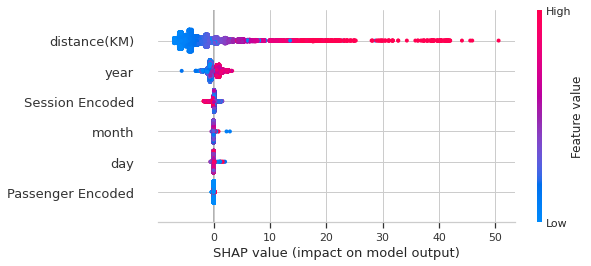

In [60]:
# Model Explainability
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)
# summarize the effects of all the features
shap.summary_plot(shap_values, X_test)